In [ ]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
#%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12621, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 12621 (delta 0), reused 1 (delta 0), pack-reused 12618
Receiving objects: 100% (12621/12621), 12.46 MiB | 29.53 MiB/s, done.
Resolving deltas: 100% (8651/8651), done.
/content/yolov5
     |████████████████████████████████| 596 kB 8.3 MB/s 
Setup complete. Using torch 1.12.0+cu113 (Tesla P100-PCIE-16GB)


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#!unzip "/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe-to-code.v4i.yolov5pytorch.zip" -d "/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/"



Archive:  /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe-to-code.v4i.yolov5pytorch.zip
 extracting: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/README.dataset.txt  
 extracting: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/README.roboflow.txt  
 extracting: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/data.yaml  
   creating: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/
   creating: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images/
 extracting: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images/0_jpg.rf.a22d17ea8dc7d10a24212a00a4fa0fac.jpg  
 extracting: /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images/11_jpg.rf.fd34e50ce7df59a94d40956197f4308a.jpg  
 extracting: /content/

# Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [ ]:
%cd /content/yolov5
import os
# Print the current working directory
print("Current working directory: {0}".format(os.getcwd()))

!python train.py --img 416  --batch 32 --epochs 100 --data /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/data.yaml --weights /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/best_400_0_8_valid.pt --cache

/content/yolov5
Current working directory: /content/yolov5
train: weights=/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/best_400_0_8_valid.pt, cfg=, data=/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=32, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.1-386-g2e57b84 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

hyperparameters:

In [ ]:
import shutil
src = '/content/yolov5/runs/train/exp8/weights/best.pt'
dst = '/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code'
shutil.copy2(src, dst)

'/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/best.pt'

# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
!python detect.py --weights /content/yolov5/runs/train/exp8/weights/best.pt --img 416 --save-crop  --conf 0.6 --source /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images

detect: weights=['/content/yolov5/runs/train/exp8/weights/best.pt'], source=/content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=True, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-386-g2e57b84 Python-3.7.13 torch-1.12.0+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16281MiB)

Fusing layers... 
Model summary: 213 layers, 7034398 parameters, 0 gradients, 15.8 GFLOPs
image 1/85 /content/gdrive/MyDrive/ml/Modern_Computer_Vision/website_image/wireframe_to_code/train/images/0_jpg.rf.a22d17ea8dc7d10a24212a00a4fa0fac.jpg: 416x416 1 button, 1 checkbox, 1 container, 1 footer, 1 frame, 1 heading, 3 inputs, 1 nav, 1 text, Done. (

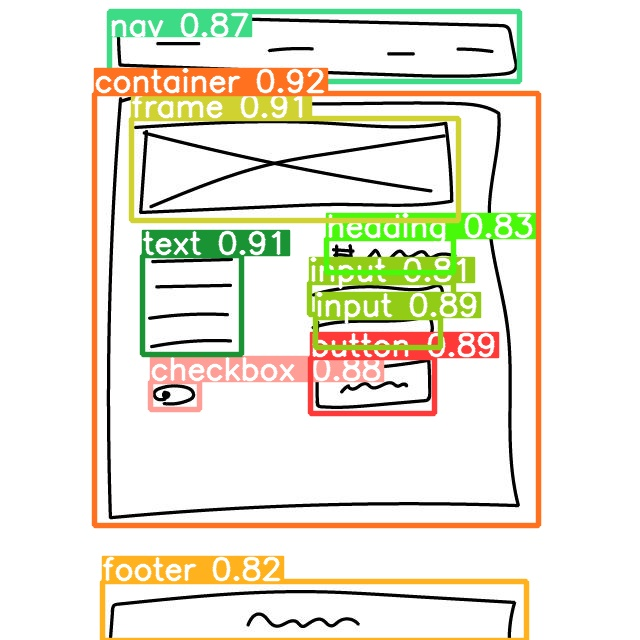

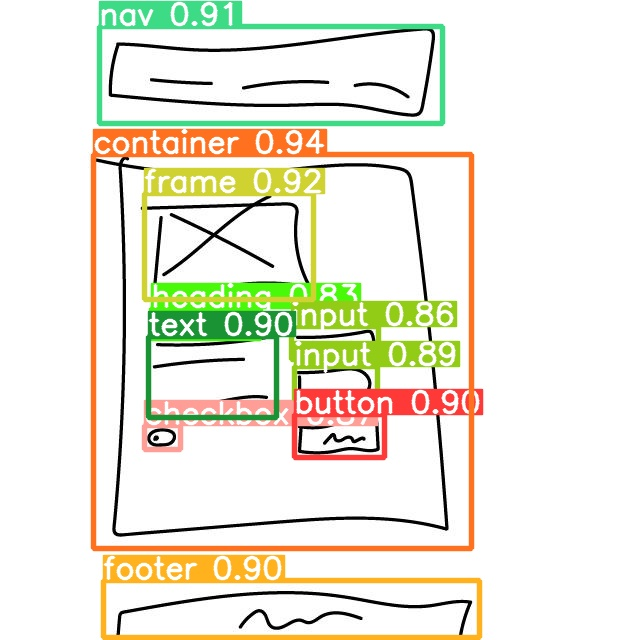

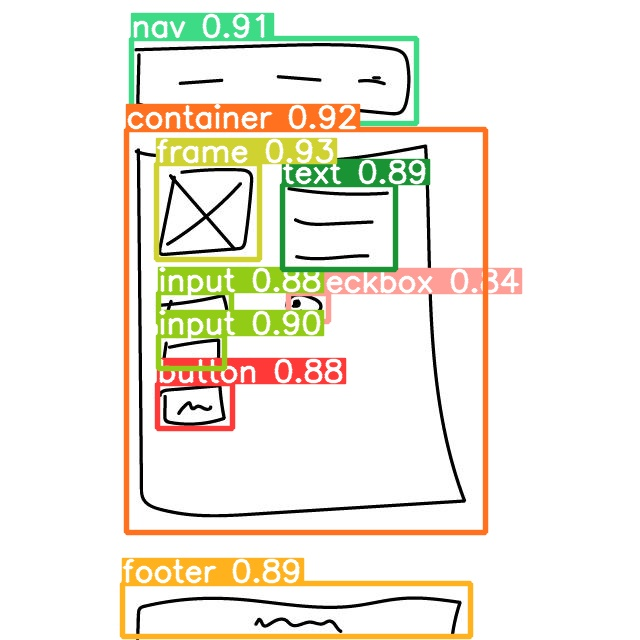

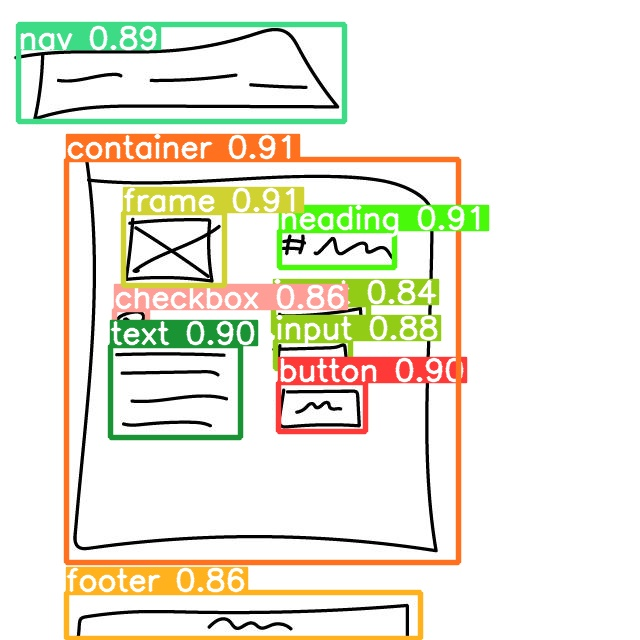

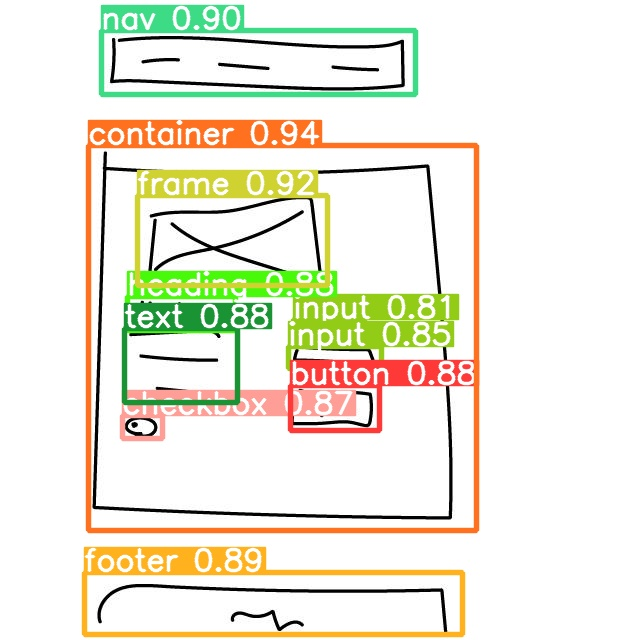

...

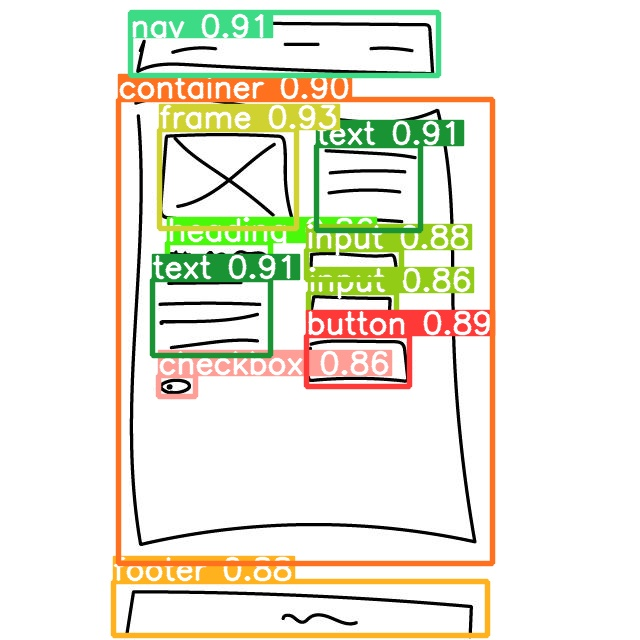

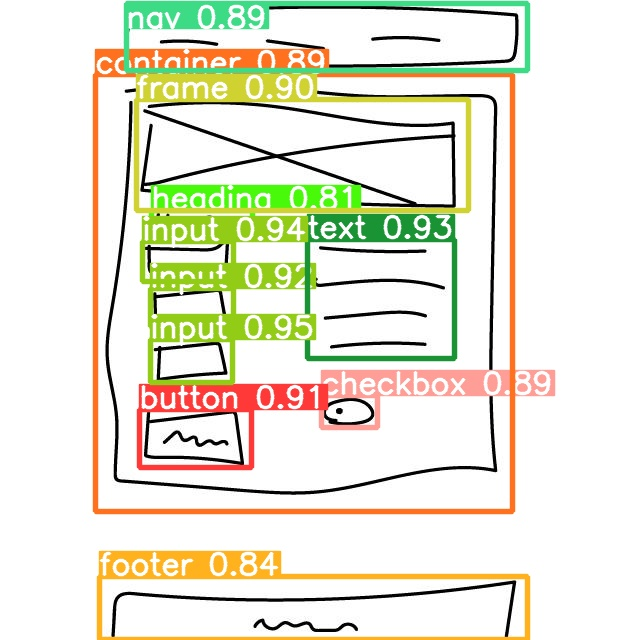

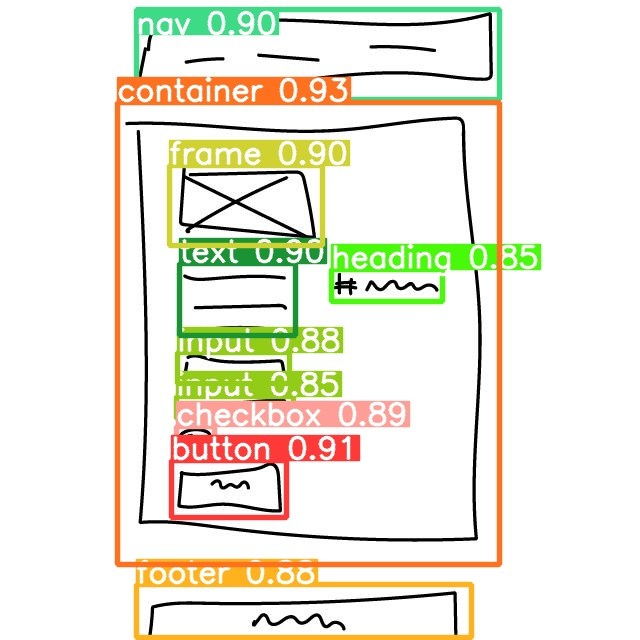

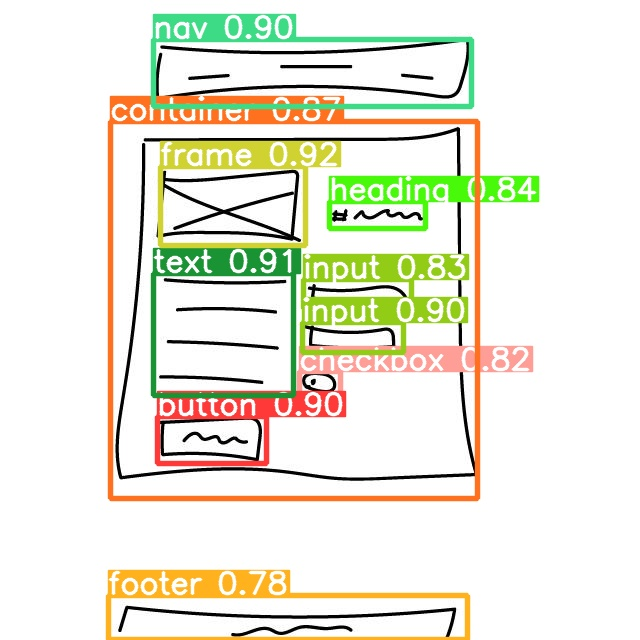

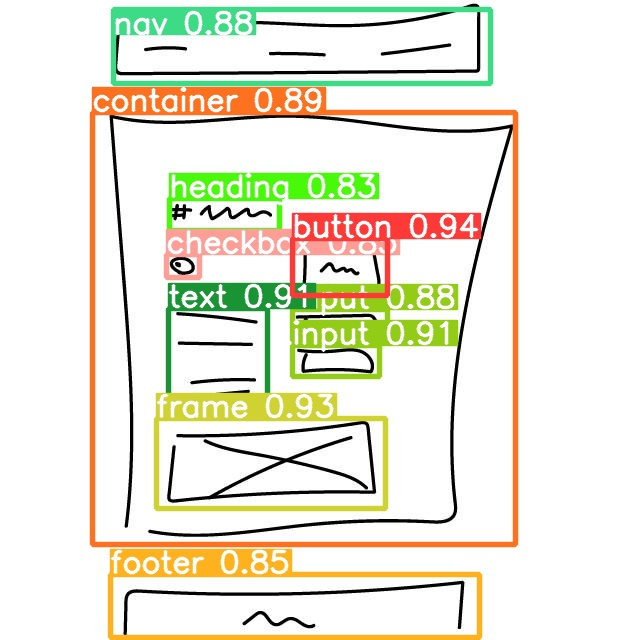

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")